<a href="https://colab.research.google.com/github/andandandand/practical-computer-vision/blob/main/notebooks/Tutorial_Part2_Downloading_Images_to_Google_Drive_and_Creating_Embeddings.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

# Tutorial - Downloading Images to Google Drive and Creating Embeddings
#### Author: Antonio Rueda-Toicen
**antonio.rueda.toicen 'at' hpi 'dot' de**


[![Creative Commons License](https://i.creativecommons.org/l/by/4.0/88x31.png)](http://creativecommons.org/licenses/by/4.0/)

This work is licensed under a [Creative Commons Attribution 4.0 International License](http://creativecommons.org/licenses/by/4.0/).

## Downloading Paintings to Google Drive and Creating Image Embeddings

In this notebook, we will explore the process of downloading paintings from the web and converting them into numerical representations known as embeddings. These embeddings can be used in various machine learning tasks such as similarity search, clustering, and more. We'll break down the process into several steps, explaining each part in detail.

This tutorial is part 1 of a series on image similarity.

To create your own `urls.txt` file with the image addresses, please follow [this tutorial by Adrian Rosebrock](https://pyimagesearch.com/2018/04/09/how-to-quickly-build-a-deep-learning-image-dataset/).

The image scraping script from this tutorial can be found [here](https://github.com/aihpi/practical-computer-vision-with-pytorch/blob/main/image_scraping/google_images_scraper.js) and the `urls.txt` file [here](https://github.com/aihpi/practical-computer-vision-with-pytorch/blob/main/artifacts/urls.txt).
The folder with the downloaded images is available [here](https://drive.google.com/drive/folders/1l7VvTnRwWpo4_wPPMrUcmMtKeaxuFTfY?usp=drive_link).
Right click on the folder name and select "Add Shortcut to Drive" in order to add to your own Drive.


### 0. Mounting Google Drive and Reading Image Urls

This part of the code is responsible for mounting Google Drive, allowing us to access files stored there.

In [ ]:
from google.colab import drive
drive.mount('/gdrive')

Drive already mounted at /gdrive; to attempt to forcibly remount, call drive.mount("/gdrive", force_remount=True).




This section reads a list of image URLs from a file. These URLs will be used to download the images.

In [ ]:
from pathlib import Path
import os
artist_name = 'banksy'
path = Path(f'/gdrive/MyDrive/art_recommendation/{artist_name}')

In [ ]:
# here urls.txt should appear
os.listdir(path)

['urls.txt', 'paintings', 'paintings_embeddings.pickle']

In [ ]:
with open(path / 'urls.txt', 'r') as f:
   # https://stackoverflow.com/a/12330535/45963
  image_urls = f.read().splitlines()

# Here we should read a url
image_urls[2]

'https://sothebys-com.brightspotcdn.com/74/98/f4ad821547df928be67569aa1202/gettyimages-501590118.jpg'

### 1. Importing Image Libraries

We'll start by importing the necessary libraries that will help us in manipulating images and working with images.

In [ ]:
import skimage.io as io
from PIL import Image

img_array =io.imread(image_urls[2])
img_array.shape

(2938, 4727, 3)

### 2. Loading an Image

Here, we'll load an image from an array and convert it into a format suitable for further processing.

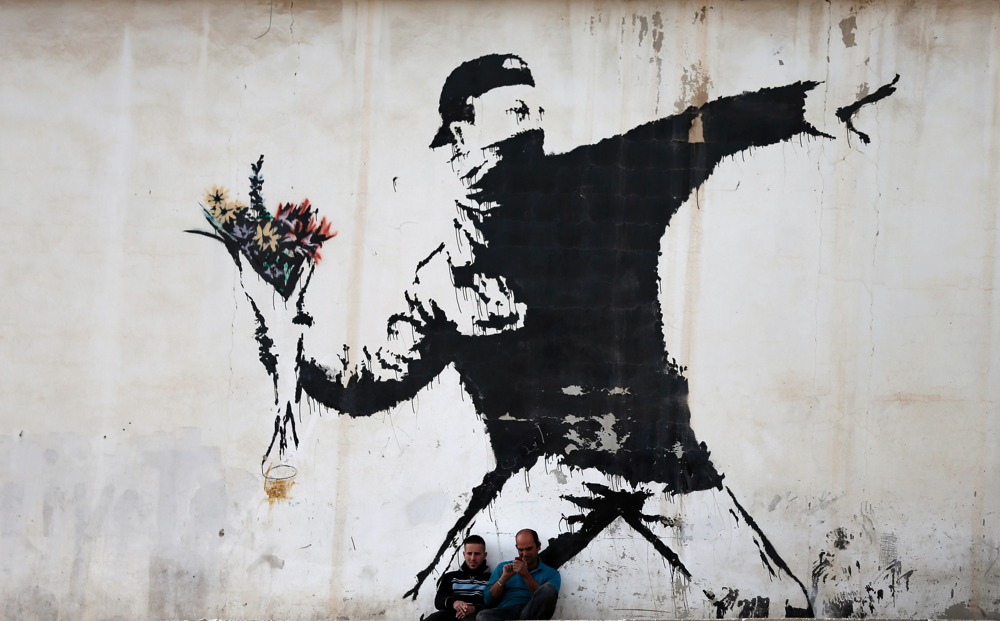

In [ ]:
image = Image.fromarray(img_array)
image

### 3. Defining and Initializing Image Embedding Model

We will define a model that can convert images into numerical vectors called embeddings. This model is then initialized for usage. **Don't worry about the details of this model.** For now, you can treat it as a black box that turns images into vectors of numbers. Similar images will turn into vectors that are close to each other.

In [ ]:
import torch
import torchvision.models as models
import torchvision.transforms as transforms
from torchvision.models import ResNet34_Weights
from PIL import Image

# Load the pretrained ResNet34 model
model = models.resnet34(weights=ResNet34_Weights.IMAGENET1K_V1)

# Remove the final classification layer to get embeddings
model = torch.nn.Sequential(*list(model.children())[:-1])

# Set model to evaluation mode
model.eval()

# Define the image transformation
transform = transforms.Compose([
    transforms.CenterCrop(224),
    transforms.ToTensor(),
    transforms.Normalize(mean=[0.485, 0.456, 0.406],
                         std=[0.229, 0.224, 0.225]),
])

# Function to extract embeddings from an image
def extract_embedding(image):
    image = transform(image).unsqueeze(0)  # Add batch dimension
    with torch.no_grad():
        embedding = model(image)
    return embedding.squeeze().numpy()

# Example usage
embedding = extract_embedding(image)
print(embedding.shape)


(512,)


### 5. Setting Up Paths

We define the paths where the images and other related data are located. This helps in organizing and accessing the files easily.

### 6. Saving Images

This section shows how to save an image to a specific location on the drive.

In [ ]:
#os.mkdir(path/'paintings')
filename1 = path/f'paintings/{artist_name}_1.jpg'
image.save(filename1)

### 7. Creating Image Embeddings

Here, we use the initialized model to convert an image into an embedding. This numerical representation can be used for various purposes in machine learning.

In [ ]:
embedding1 = extract_embedding(image)
embedding1

array([3.52295327e+00, 1.27505407e-01, 0.00000000e+00, 2.40297824e-01,
       2.14459613e-01, 3.18585485e-01, 3.08619952e-03, 8.57560635e-01,
       1.24627542e+00, 3.44120771e-01, 1.01166099e-01, 1.86415446e+00,
       1.68815345e-01, 3.89252007e-01, 1.68814456e+00, 3.14847708e+00,
       2.75281444e-02, 2.25820255e+00, 8.74256343e-02, 4.25024539e-01,
       1.61707914e+00, 2.91039445e-03, 1.35584269e-02, 5.13307601e-02,
       1.09875572e+00, 3.08450282e-01, 1.49352372e-01, 1.37250733e+00,
       3.40793371e-01, 1.89341938e+00, 1.35361826e+00, 5.10325551e-01,
       1.07881320e+00, 0.00000000e+00, 1.09638758e-02, 1.02023341e-01,
       8.73368084e-01, 9.01135981e-01, 9.76876542e-03, 1.46854162e-01,
       1.53523266e+00, 5.85998654e-01, 5.29768705e-01, 0.00000000e+00,
       5.28901398e-01, 2.05977987e-02, 1.64728522e-01, 1.72331583e+00,
       6.19615568e-03, 6.61581159e-02, 2.68568277e-01, 8.12079478e-03,
       5.18957563e-02, 6.75194561e-01, 5.76330945e-02, 1.47232935e-01,
      

In [ ]:
# Now we put the image embedding into a dictionary with the filename as key
paintings_embedded_dict = {filename1:embedding1}

### 8. Downloading Images with `skimage.io.imread()`

We loop through the URLs and download each image, handling exceptions if any issues arise during the download.

In [ ]:
for index, url in enumerate(image_urls):
  try:
   #import pdb; pdb.set_trace()
   image = Image.fromarray(io.imread(url)[:,:,:3])
   filename = path/'paintings'/f'{artist_name}_0{index}.jpg'
   image.save(filename)
   embedding = extract_embedding(image)
   paintings_embedded_dict[filename] = embedding
   #comment out the break line to get the file
   break
  except:
    continue

### 9. Saving Embeddings

Once the images are converted into embeddings, we save them to a file for future use.

In [ ]:
# check out the integrity of our pickle file
import pickle
with open(path / 'paintings_embeddings.pickle', 'wb') as handle:
    pickle.dump(paintings_embedded_dict, handle, protocol=pickle.HIGHEST_PROTOCOL)

with open(path / 'paintings_embeddings.pickle', 'rb') as handle:
    b = pickle.load(handle)

assert len(b.keys()) == len(paintings_embedded_dict.keys())

### 10. Checking the Format of the Keys in Our Dictionary
Each key in our dictionary should have the [**full path**](https://courses.cs.washington.edu/courses/cse140/13wi/file-interaction.html#:~:text=Absolute%20and%20Relative%20file%20paths&text=An%20absolute%20file%20path%20describes,For%20example%2C%20example_directory.), not the relative path to the images. We can check this by inspecting the filenames and using `Image.open()`.

In [ ]:
# These should be fully formed paths, we should be able to open all of these images
# from Google Drive
b.keys()

dict_keys([PosixPath('/gdrive/MyDrive/art_recommendation/banksy/paintings/banksy_1.jpg'), PosixPath('/gdrive/MyDrive/art_recommendation/banksy/paintings/banksy_02.jpg')])

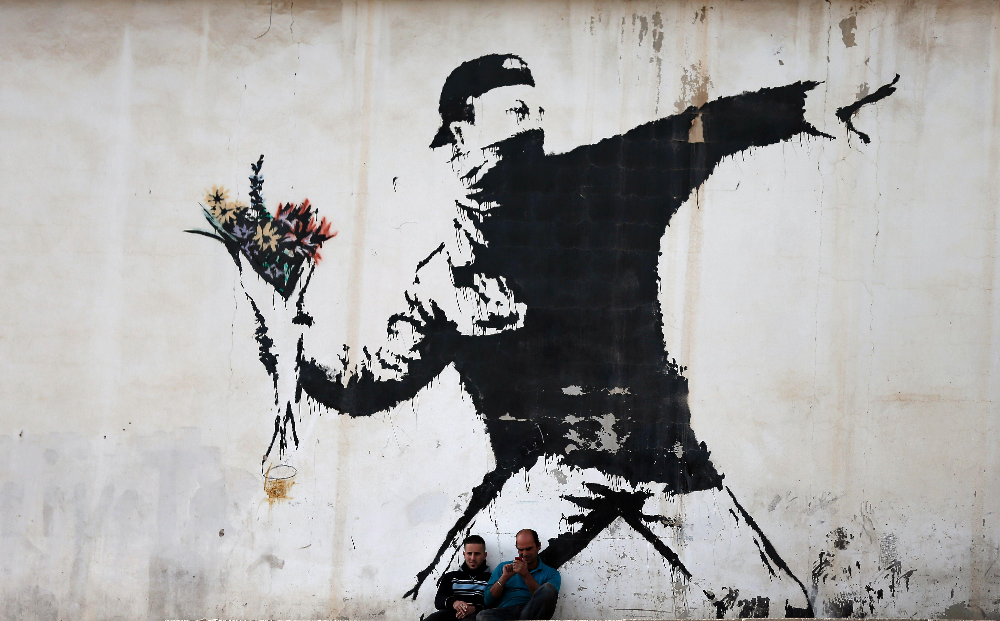

In [ ]:
# Check that the keys correspond to valid paths
Image.open(list(b.keys())[-1])

## References

* Adrian Rosebrok's [guide on downloading from Google Images](https://pyimagesearch.com/2018/04/09/how-to-quickly-build-a-deep-learning-image-dataset/)